<a href="https://colab.research.google.com/github/gabrielraya/intraretinal-cyst-fluid-detection/blob/master/code/cystoid_detection_first_model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Intraretinal cyst fluid detection using Deep Learning
<img src="https://github.com/gabrielraya/intraretinal-cyst-fluid-detection/blob/master/code/images/project.png?raw=1" width="350" height="350" align="right">

*Abstract— This work aims to develop an algorithm for automatic segmentation of fluid types in retina fundus images using U-net, with annotated images provided by two clinical centers, which were acquired with the three most common [OCT](https://en.wikipedia.org/wiki/Optical_coherence_tomography) device vendors from patients with two different retinal diseases*.  

The rest of the project can be found on the [intraretinal-cyst-fluid-detection](https://github.com/gabrielraya/intraretinal-cyst-fluid-detection) repository on Github. 

**Challenge**: [https://icon.grand-challenge.org/](https://icon.grand-challenge.org/)



## Clinical background

Age-related macular degeneration (AMD) is the most prevalent cause for blindness in the developed world. Over the last ten years, anti-VEGF intravitreal injections for the treatment of AMD have had an impact on disease progression globally and have provided patients with many valuable additional years of vision. The success of anti-VEGF treatment is reliant on the accurate assessment of individual disease activity, specifically the evaluation of location, size and evolution of fluid, such as intraretinal cysts. Fluid accumulation is best visualized on optical coherence tomography (SD-OCT) imaging, an almost indispensable tool in the assessment of AMD treatment success. Therefore, for each injection, information about fluid is extracted from an OCT scan, a prediction is made and this is distilled into a treatment decision. Currently, this is a manual process, performed by the treating clinician and requires a large amount of time for every treatment. 

The Intraretinal Cyst segmentatiON (ICON) challenge aims at evaluating and comparing automated algorithms for the segmentation of intraretinal cyst fluid, a type of fluid correlated with AMD treatment response. These algorithms could provide expert support to clinicians during treatment decision and to substantially improve the quality of AMD care. We have produced ground truth semantic segmentations for 175 OCT scans. 122 of these will be released for model training and validation, and the remaining 53 will be held out for objective model evaluation.



## Data
<img src="https://github.com/gabrielraya/intraretinal-cyst-fluid-detection/blob/master/code/images/img1_raw_data.png?raw=1" width="400" height="250" align="right">

In this project, we are going to develop a system to automatically **detect intraretinal cyst fluids** in human retina fundus images. For this purpose, we are going to use data from the **RETOUCH dataset**, a similar version used for the  (https://retouch.grand-challenge.org/). The original dataset is an anonymized collection of a total of 112 maculacentered OCT volumes of 122 patients from Medical University of Vienna (MUV) in Austria, and the Erasmus  University Medical Center (ERASMUS). A total 122 OCT volumetric scans (11,334 B-scans) and manual annotations for training. 

The original GlaS dataset consists of  122 OCT volumetric scans (11,334 B-scans), X used for training and Y used for testing. Each case contains:
* a small crop of a fundus (8-bit) image
* manual annotations of ICF, provided as a binary map

Similar to what done in the original U-Net paper, the main task of this ICON challenge is **instance segmentation**, meaning that participants in the challenge have to build a model that is good at separating *FLUIDS* from background (segmentation) but also at identifying/detecting *FLUIDS*. Therefore, the type of manual annotations that come with the original RETOUCH dataset dataset is similar to what shown in the image on the right in this cell. You can clearly see that each FLUID in the manually annotated mask gets only one label. Additionally, the size of images in the original dataset is not fixed and is approximately 500 x 700 pixels.



### "Binary ICON 256"
In the preprocessing part, we have simplified things a bit. In particular:
* we have resized all images to 256x256, both in the training and in the test set
* we have converted all manual annotations to a binary form, removing the task of instance segmentation
* **Unbalanced class**: Most of the scans are not label, which means that the data label is skwed to the first class (background)

Examples of images in the dataset of this dataset (which we can call "binary icon 256") are the following:

<table>
<tr>
<td><img src="https://github.com/gabrielraya/intraretinal-cyst-fluid-detection/blob/master/code/images/pat1_scan17.png?raw=1" width="200" height="150" align="left"></td>
<td><img src="https://github.com/gabrielraya/intraretinal-cyst-fluid-detection/blob/master/code/images/pat1_scan17_anno.png?raw=1" width="200" height="200" align="left"></td>
<td><img src="https://github.com/gabrielraya/intraretinal-cyst-fluid-detection/blob/master/code/images/pat2_scan17.png?raw=1" width="200" height="150" align="left"></td>
<td><img src="https://github.com/gabrielraya/intraretinal-cyst-fluid-detection/blob/master/code/images/pat2_scan17_anno.png?raw=1" width="200" height="200" align="left"></td>
<td><img src="https://github.com/gabrielraya/intraretinal-cyst-fluid-detection/blob/master/code/images/pat3_scan16.png?raw=1" width="200" height="200" align="left"></td>
<td><img src="https://github.com/gabrielraya/intraretinal-cyst-fluid-detection/blob/master/code/images/pat3_scan16_anno.png?raw=1" width="200" height="200" align="left"></td>
<td><img src="https://github.com/gabrielraya/intraretinal-cyst-fluid-detection/blob/master/code/images/pat4_scan16.png?raw=1" width="200" height="200" align="left"></td>
<td><img src="https://github.com/gabrielraya/intraretinal-cyst-fluid-detection/blob/master/code/images/pat4_scan16_anno.png?raw=1" width="200" height="200" align="left"></td>
</tr>
</table>


This means that the datasets this project uses are a modified version of the original ones, and are only valid for the purpose of this project. **Notice that the images are display in color but all the images are 8-bit images (0-255) while the annotated images are binary images (0-1)**. Previous images were manually select for visualization purposes, a lot of images labeled as background were discarded for this purpose.


# Tasks
The main tasks of this assignment are the following:

### 1. Train a baseline U-Net model (5 points)
### 2. Implement a basic ``unet_block`` with batch normalization, build and train a new U-Net model (30 points)
### 3. Add regularization by adding dropout to the unet_block and an L2 regularization loss (25 points)
### 4. Use weight maps (25 points)
### 5. Use valid convolutions (35 points)

Let's get started!


## Libraries

First, we import the basic libraries necessary to develop this assignment. Feel free to include more libraries if needed.


In [1]:
# Run this when using Colab
!pip install SimpleITK
!pip install -U pydicom

     |████████████████████████████████| 42.5MB 2.4MB/s 
     |████████████████████████████████| 7.0MB 2.6MB/s 


In [0]:
from tqdm import tnrange, tqdm_notebook
import os
import SimpleITK as sitk
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import random
#from PIL import Image
matplotlib.rcParams['figure.figsize'] = [8, 6]
#from IPython.display import clear_output

%matplotlib inline

import tensorflow as tf
from keras.models import Model#, load_model
from keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate, BatchNormalization # Dropout, Cropping2D, Reshape,
#from keras import optimizers
from keras.optimizers import SGD#, Adam
#from keras import regularizers
import keras.callbacks
#from utils import *
#from keras import backend as K

This code is add to manage efficiently the GPU memory allocation

In [0]:
# adding growth parameter for GPU memory allocation
from keras.backend.tensorflow_backend import set_session
config = tf.ConfigProto()
config.gpu_options.allow_growth = True  # dynamically grow the memory used on the GPU
config.log_device_placement = True  # to log device placement (on which device the operation ran)
                                    # (nothing gets printed in Jupyter, only if you run it standalone)
sess = tf.Session(config=config)
set_session(sess)  # set this TensorFlow session as the default session for Keras
#!pip install comet_ml

## Data

This notebook has been prepared to work directly from Colab but you can also work from any other resource.  The next cells import the data from the drive team folder, but you can also directly download the zip file from  [drive](https://drive.google.com/open?id=1Y2XKig36mh2WuJ-1ArJWoF-tlgKp8UnT).  To do so, you need to give Colab acces to your drive account.

In [3]:
# Only run this code when using Colab
from google.colab import drive
drive.mount('/content/gdrive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/gdrive


Define the path where data is stored

In [0]:
#DATA_FOLDER = './cyst_segmentation_ISMI_training_set/'                                  # Local System
DATA_FOLDER = 'gdrive/Team Drives/ISMI-FinalProject/cyst_segmentation_ISMI_training_set/' # Colab
TEST_FOLDER = 'gdrive/Team Drives/ISMI-FinalProject/cyst_segmentation_ISMI_test_set/cyst_segmentation_ISMI_test_set'

In [16]:
!ls 'gdrive/Team Drives/ISMI-FinalProject/cyst_segmentation_ISMI_training_set/'
!ls 'gdrive/Team Drives/ISMI-FinalProject/cyst_segmentation_ISMI_test_set/cyst_segmentation_ISMI_test_set'
#!ls './cyst_segmentation_ISMI_training_set'

 annotations   data_usage_policy.pdf  'first_try_unet (5).ipynb'   images
images


Check that the data folder contains the following structure:
````
cyst_segmentation_ISMI_training_set
  |-images
    |-pat001_im001.mdh
    |-pat001_im001.raw
    |-...
  |-annotations
    |-pat001_im001.mhd
    |-pat001_im001.zraw
    |-...
````

###  Data Inspection

This first part consists in reconstructing the given images from the raw data acquired with the tommoography machine. There are several steps that have to be applied to reconstruct a gray-scale image that can actually be read by radiologists with the aim of detecting these three type of fluids in the retina.

**This process might take some time** : Please, be patient. This is reading the 112 volumentric with their n-corresponding B scans.

In [0]:
def get_file_list(path, ext=''):
    return sorted([os.path.join(path, f) for f in os.listdir(path) if f.endswith(ext)])

def load_img(path):
    return sitk.GetArrayFromImage(sitk.ReadImage(path))

In [0]:
# get path names list of raw data in ITK format
x_img_files = get_file_list(os.path.join(DATA_FOLDER,'images/'), 'mhd')
y_img_files = get_file_list(os.path.join(DATA_FOLDER,'annotations/'), 'mhd')
x_test_files = get_file_list(os.path.join(TEST_FOLDER,'images/'), 'mhd')

# read ITK files using SimpleITK and conver then into a list of numpy arrays
X = [load_img(f) for f in x_img_files]
Y = [load_img(f) for f in y_img_files]
X_test = [load_img(f) for f in x_test_files]

Let's verify the number of X sample files is the same as the number of annotated images Ys.

In [21]:
print("Number of list files X:{} , Y:{}".format(len(x_img_files),len(y_img_files)))
print("Number of samples X:{} , Y:{}".format(len(X),len(Y)))
print("Shape of first volumetric object X[0]: {}".format(X[0].shape))

Number of list files X:122 , Y:122
Number of samples X:122 , Y:122
Shape of first volumetric object X[0]: (18, 496, 508)


In [22]:
print("Number of list files X:{}".format(len(x_test_files)))
print("Number of samples X:{}".format(len(X_test)))
print("Shape of first volumetric object X_test[0]: {}".format(X_test[0].shape))

Number of list files X:52
Number of samples X:52
Shape of first volumetric object X_test[0]: (18, 496, 521)


Define a function to visualize (1) the b-scan image, (2) the manual annotation. Notice the use of the argument ```cmap``` to change the ```colormap``` of the visualization. 

In [0]:
def show_image(img, lbl):
    s, h, w = img.shape 
    for i in range(s):
        plt.subplot(1,2,1)
        plt.imshow(img[i])#, cmap='gray')
        plt.title('Input image')

        plt.subplot(1,2,2)
        plt.imshow(lbl[i])#, cmap='gray')
        plt.title('Manual annotation')
        plt.show()
     
def show_image2(img):
    s, h, w = img.shape 
    for i in range(s):
        plt.subplot(1,2,1)
        plt.imshow(img[i])#, cmap='gray')
        plt.title('Test image')
        plt.show()

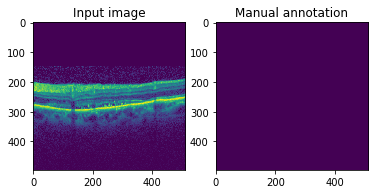

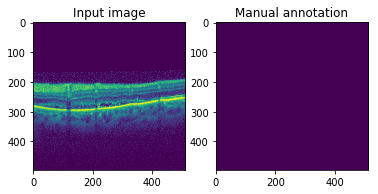

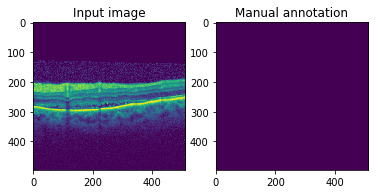

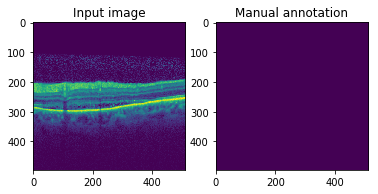

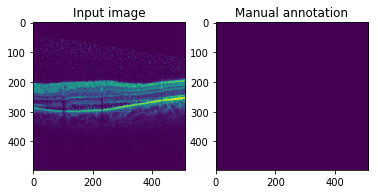

...

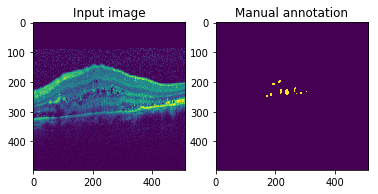

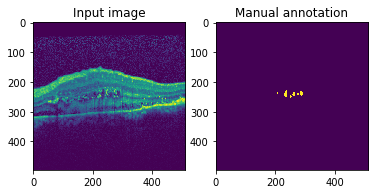

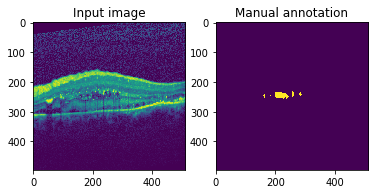

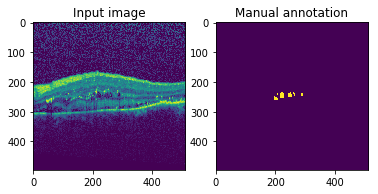

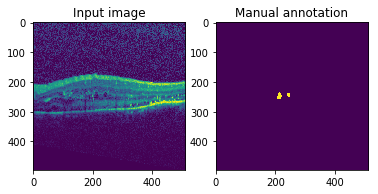

In [24]:
i = 21  # select the image 
show_image(X[i], Y[i])

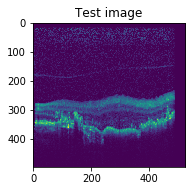

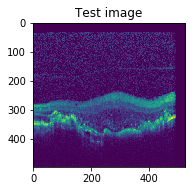

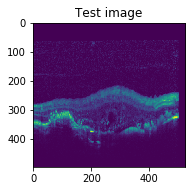

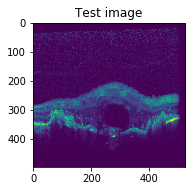

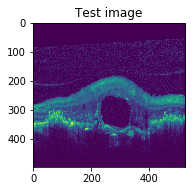

...

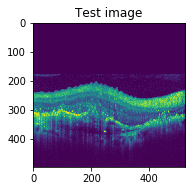

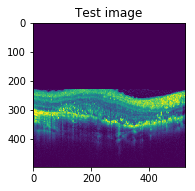

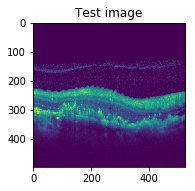

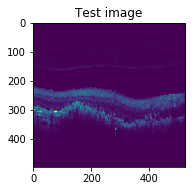

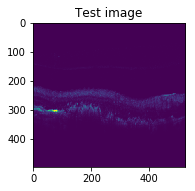

In [28]:
i = 21  # select the image 
show_image2(X_test[i])

Let's define some Helper classes and functions

In [0]:

class Image:
  
    def __init__(self, img, label=None, name=None):
        '''
        Inputs:
        img: image as a numpy array
        label: labels of the image as np image
        name: the filename of the image
        '''
        self.img = img
        self.label = label
        self.name = name
    
    def get_img(self):
        return self.img
  
    def get_label(self):
        return self.label
  
    def get_lenght(self):
        return len(self.imgs)
  
    def show_image(self):
        f, axes = plt.subplots(1, 2)
        for ax, im, t in zip(axes, 
                                 (self.imgs[i], self.lbls[i]), 
                                 ('8-bit image', 
                                  'Manual annotation; Range: [{}, {}]'.format(self.lbls[i].min(), 
                                                                              self.lbls[i].max()))):
            ax.imshow(im)
            ax.set_title(t)
        plt.show()
      

# TODO: add name to dataset
class DataSet:
    
    def __init__(self, imgs, lbls=None):
        self.imgs = imgs
        self.lbls = lbls
    
    def get_lenght(self):
        return len(self.imgs)
    
    def show_image(self, i):
        if self.lbls != None:
            f, axes = plt.subplots(1, 2)
            for ax, im, t in zip(axes, 
                                 (self.imgs[i].reshape(480,480), self.lbls[i].reshape(480,480)), 
                                 ('8-bit image', 
                                  'Manual annotation; Range: [{}, {}]'.format(self.lbls[i].min(), 
                                                                              self.lbls[i].max()))):
                ax.imshow(im)
                ax.set_title(t)
        else:
            plt.imshow(self.imgs[i].reshape(480,480))
            plt.title('RGB image')
        plt.show()
        
    def show_image2(self, i):
        if self.lbls != None:
            f, axes = plt.subplots(1, 2)
            for ax, im, t in zip(axes, 
                                 (self.imgs[i].reshape(480,480), self.lbls[i].reshape(480,480)), 
                                 ('8-bit image', 
                                  'Manual annotation; Range: [{}, {}]'.format(self.lbls[i].min(), 
                                                                              self.lbls[i].max()))):
                ax.imshow(im)
                ax.set_title(t)
        else:
            plt.imshow(self.imgs[i])
            plt.title('RGB image')
        plt.show()
        
        
class BatchCreator:
    
    def __init__(self, dataset, target_size):
        #self.patch_extractor = patch_extractor
        self.target_size = target_size # size of the output, can be useful when valid convolutions are used
        
        self.imgs = dataset.imgs
        self.lbls = dataset.lbls
                
        self.n = len(self.imgs)
        #self.patch_size = self.patch_extractor.patch_size
    
    def create_image_batch(self, batch_size):
        '''
        returns a single augmented image (x) with corresponding labels (y) in one-hot structure
        '''
        x_data = np.zeros((batch_size, *self.target_size, 1))
        y_data = np.zeros((batch_size, *self.target_size, 2)) # one-hot encoding with 2 classes
        
        for i in range(0, batch_size):
        
            random_index = np.random.choice(len(self.imgs)) # pick random image
            img, lbl = self.imgs[random_index], self.lbls[random_index] # get image and segmentation map
            
           # clear_output()
            #patch_img, patch_lbl = self.patch_extractor.get_patch(img, lbl) # when image size is equal to patch size, this line is useless...
          #  img, lbl = 
            # crop labels based on target_size
            #h, w, _ = patch_lbl.shape
            #ph = (self.patch_extractor.patch_size[0] - self.target_size[0]) // 2
            #pw = (self.patch_extractor.patch_size[1] - self.target_size[1]) // 2
            #patch_img = patch_img.reshape(tuple(list(patch_img.shape) + [1]))
            x_data[i, :, :, :] = img
            y_data[i, :, :, 0] = 1 - lbl
            y_data[i, :, :, 1] = lbl
        
        return (x_data.astype(np.float32), y_data.astype(np.float32))
    
    def get_image_generator(self, batch_size):
        '''returns a generator that will yield image-batches infinitely'''
        while True:
            yield self.create_image_batch(batch_size)

Since the output of U-Net may not have the same size as its input, let's define a function pad_prediction() that visualizes labels adding padding, to match the input size.

In [0]:
def pad_prediction(prediction, input_size, pad_with=-1.0):
    """Only for visualization purpose, it introduces artificial -1."""
    pad_pred = pad_with * np.ones(input_size).astype(float)
    pred_size = prediction.shape
    D = ((input_size[0]-pred_size[0])//2, (input_size[1]-pred_size[1])//2)
    pad_pred[D[0]:D[0]+pred_size[0], D[1]:D[1]+pred_size[1]] = prediction
    return pad_pred

As we have seen, manual annotations in the Icon challenge come with only one label per cyst fluid instance.  We are just going to treat all manually annotated objects as belonging to the same class. Therefore, we have modified the labels in the dataset by just using label=1 for cyst fluids and label=0 for background. When we saved this map to disk, background got value 0 and foreground got value 255 (as you can see in the previous cells showing manual annotations of training and validation images). In order to be able ot use these annotations, we have to convert them to [0, 1] values. For this purpose, we define the following function, wich we will apply to the validation and to the training set. Discussion has to be made to make sure that this is what we have to do.

In [0]:
def binarize_dataset(dataset): 
    return DataSet(dataset.imgs, [(x>0).astype(int) for x in dataset.lbls])

Let's also we define a function that allows to apply the model to a given dataset, which will be used a lot to test your models and visualize results. Note that this function includes a parameter to make a submission file, which will be called ``results.zip``, to be submitted to grand-challenge. By default, this parameter is set to ``False``. Enable it later to make subsmission files.

Let's also define a Logger class that will store useful information during training:

In [0]:
def apply_model(model, dataset, experiment_name='basic_unet', make_submission_file=False):
    """Apply a given model to the test set, optionally makes a submission file in ZIP format."""
    
    output_dir = os.path.join(data_dir, experiment_name)
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    for i in range(len(dataset.imgs)):
        fig = plt.figure(figsize=(10,20))
        input_img = np.expand_dims(dataset.imgs[i], axis=0)/255.
        output = model.predict(input_img, batch_size=1)[0, :, :]
        plt.subplot(1, 2, 1); plt.imshow(dataset.imgs[i].reshape(480,480))
        plt.subplot(1, 2, 2); plt.imshow(np.argmax(output, axis=2))
        if make_submission_file:
            prediction = Image.fromarray(np.argmax(output, axis=2).astype(np.uint8))
            prediction.save(os.path.join(output_dir, '{}.png'.format(i)))
        plt.show()
        
    if make_submission_file:
        shutil.make_archive('results', 'zip', output_dir)

Images in the training set are currently in the same order as read from disk. To avoid any bias possibly introduced by this order, it is always good to shuffle the training dataset. Note that images and annotations must be shuffled in the same way!

In [0]:
def crop(masks, lost_border):
    ph = lost_border[0] // 2
    pw = lost_border[1] // 2
    h, w = masks[0].shape    
    return np.array(masks)[:, ph:h-ph, pw:w-pw]   

def calculate_dice(x, y):
    '''returns the dice similarity score, between two boolean arrays'''
    return 2 * np.count_nonzero(x & y) / (np.count_nonzero(x) + np.count_nonzero(y))
    
class Logger(keras.callbacks.Callback):

    def __init__(self, validation_data, lost_border, data_dir, model_name):
        self.val_imgs = np.array(validation_data.imgs) / 255.
        self.val_lbls = crop(validation_data.lbls, lost_border)
        self.model_filename = os.path.join(data_dir, model_name + '.h5')
        
        self.losses = []
        self.dices = []
        self.best_dice = 0
        self.best_model = None
        
        self.predictions = None
    
    def on_batch_end(self, batch, logs={}):
        self.losses.append(logs.get('loss'))
        self.losses.append(logs.get('acc'))
    
    def on_epoch_end(self, batch, logs={}):
        dice = self.validate()
        self.dices.append([len(self.losses), dice])
        if dice > self.best_dice:
            self.best_dice = dice
            self.model.save(self.model_filename) # save best model to disk
            print('best model saved as {}'.format(self.model_filename))
        self.plot()   
    
    def validate(self):
        self.predictions = self.model.predict(self.val_imgs, batch_size=1)
        predicted_lbls = np.argmax(self.model.predict(self.val_imgs, batch_size=1), axis=3)
        x = self.val_lbls>0
        y = predicted_lbls>0
        return calculate_dice(x, y)

    def plot(self):
        #clear_output()
        N = len(self.losses)
        plt.figure(figsize=(50, 10))
        plt.subplot(1, 5, 1)
        plt.plot(range(0, N), self.losses); plt.title('losses')
        plt.subplot(1, 5, 2)
        plt.plot(*np.array(self.dices).T); plt.title('dice')
        plt.subplot(1, 5, 3)
        plt.imshow(self.val_imgs[1].reshape(480,480)); plt.title('RGB image')
        plt.subplot(1, 5, 4)
        plt.imshow(np.argmax(self.predictions[1], axis=2)); plt.title('prediction')
        plt.subplot(1, 5, 5)
        plt.imshow(self.val_lbls[1]); plt.title('ground truth')
        plt.show()

Finally, let's define a function ``train_model`` that trains our model using training parameters and training/validation data:

In [0]:
# function to train a model
def train_model(model, training_params):
    patch_size = training_params['patch_size']
    target_size = training_params['target_size']
    batch_size = training_params['batch_size']
    loss = training_params['loss']
    metrics = training_params['metrics']
    logger = training_params['logger']
    epochs = training_params['epochs']
    steps_per_epoch = training_params['steps_per_epoch']
    optimizer = training_params['optimizer']
    training_dataset = training_params['training_dataset']
    validation_dataset = training_params['validation_dataset']
        
    # batch generator 
    #patch_generator = PatchExtractor(patch_size)
    batch_generator = BatchCreator(training_data, target_size=target_size)
    image_generator = batch_generator.get_image_generator(batch_size)

    # compile the model
    model.compile(optimizer=optimizer, loss=loss, metrics=metrics)

    # train the model
    model.fit_generator(generator=image_generator, 
                        steps_per_epoch=steps_per_epoch, 
                        epochs=epochs,
                        callbacks=[logger])
    

Let us define a function that help us to get all the scans contained in a dataset with OCT volumenes

In [0]:
# get scans helper function
def get_scans(training_dataset):
    train_data=[]
    train_data_lbls=[]
    # for each volumen crop all the b-scans and appends all the b-scans in one array
    for volumen in range(training_dataset.get_lenght()):
        volumen_img = training_dataset.imgs[volumen] # get i volume
        volumen_lbl = training_dataset.lbls[volumen] # get i volume label
        volumen_img_cropped = pad_n_crop_(volumen_img, 480, 480).reshape(volumen_img.shape[0],480,480,1) # crop the volume
        volumen_lbl_cropped = pad_n_crop_(volumen_lbl, 480, 480) # crop the volume
        b_scans = volumen_img.shape[0]
        # appends all the scans corresponding to volumen i
        for i in range(b_scans):
            #b_scan = DataSet(volumen_img_cropped[i,:,:], volumen_lbl_cropped[i,:,:])
            train_data.append(volumen_img_cropped[i,:,:])
            train_data_lbls.append(volumen_lbl_cropped[i,:,:])
    # return list with scans
    return train_data, train_data_lbls

Let us define other helper functions

In [0]:
def pad_n_crop_(img, cropx, cropy):
    img = np.pad(img, ((0,0),(0,0),(0,30)), mode='edge')

    _, y,x = img.shape
    startx = x//2-(cropx//2)
    starty = y//2-(cropy//2)    
    return img[:, starty:starty+cropy,startx:startx+cropx]

def show_image(img, lbl):
    matplotlib.rcParams['figure.figsize'] = (10, 6)
    s, h, w = img.shape 
    for i in range(s):
        plt.subplot(1,2,1)
        plt.imshow(img[i])
        plt.title('RGB image')

        plt.subplot(1,2,2)
        plt.imshow(lbl[i])
        plt.title('Manual annotation')
        plt.show()

## Define datasets
Now we can use the tools that we have initialized to build the datasets that we will use in this assignment.

In [0]:
# define your local directory where data is stored
data_dir = './'

In [0]:
#DATA_FOLDER = './cyst_segmentation_ISMI_training_set/'   

# get path names list of raw data in ITK format
x_img_files = get_file_list(os.path.join(DATA_FOLDER,'images/'), 'mhd')
y_img_files = get_file_list(os.path.join(DATA_FOLDER,'annotations/'), 'mhd')

# load images + manual annotations from the training set and store them in lists.
# 10 is used to reduce computational work
train_imgs = [load_img(x_img_files[f]) for f in range(10)]
train_lbls = [load_img(y_img_files[f]) for f in range(10)]

Images in the training set are currently in the same order as read from disk. To avoid any bias possibly introduced by this order, it is always good to shuffle the training dataset. Note that images and annotations must be shuffled in the same way! 
We will do this later as all the images (b-scans) corresponding to the same patient should remain on the same training or testing side (not mixed). Therefore, we first will split the data and then do the shuffle.

### Split into training and validation set
Now we can define a training and a validation set by using the Dataset class that we have defined. In order to define a validation set, you have to specify a coefficient (from 0 to 1) to indicate the percentage of training images that you want to use for validation (we have seen that typical splits are 70/30, 80/20 etc.

In [0]:
validation_percent = 0.2 # coefficient to define validation dataset (value between 0 and 1)

In [43]:
n_validation_imgs = int(validation_percent * len(train_imgs))

# use the first images as validation
validation_dataset = DataSet(train_imgs[:n_validation_imgs], train_lbls[:n_validation_imgs])

# the rest as training
training_dataset = DataSet(train_imgs[n_validation_imgs:], train_lbls[n_validation_imgs:])

# test dataset
#test_dataset = DataSet(test_imgs)

n_tra_vols = training_dataset.get_lenght()
n_val_vols = validation_dataset.get_lenght()
#n_tes_imgs = test_dataset.get_lenght()

print('{} training OCT volumes'.format(n_tra_vols))
print('{} validation OCT volumes'.format(n_val_vols))
#print('{} test images'.format(n_tes_imgs))

8 training OCT volumes
2 validation OCT volumes


So far we have split the data, but this split was done using the OCT volumes. For this reason in the next cell we extract all the b-scans, by doing so, we have verified that the split was done correctly, avoiding mixing the patient data in training or validation sets.

In [44]:
#get training data b-scans
train_data, train_data_lbl = get_scans(training_dataset)
#get validation data b-scans
validation_data, validation_data_lbl = get_scans(validation_dataset)

# Convert b-scans as Dataset object
training_data = DataSet(train_data,train_data_lbl)
validation_data = DataSet(validation_data, validation_data_lbl)

n_tra_imgs = training_data.get_lenght()
n_val_imgs = validation_data.get_lenght()
#n_tes_imgs = test_dataset.get_lenght()

print('{} training b-scans images'.format(n_tra_imgs))
print('{} validation b-scans images'.format(n_val_imgs))
#print('{} test images'.format(n_tes_imgs))

300 training b-scans images
54 validation b-scans images


### Visualize datasets
Let's visualize images in the training, the validation and the test set.


In [0]:
# set plotting size
matplotlib.rcParams['figure.figsize'] = (8, 4)

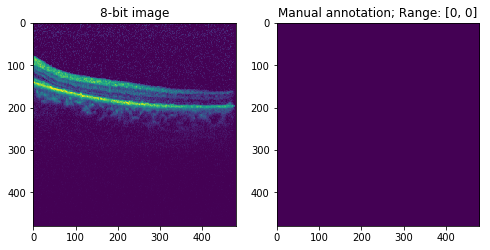

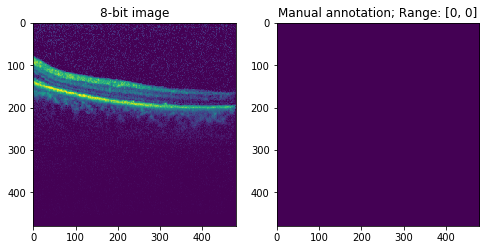

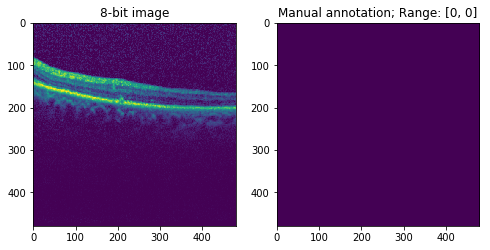

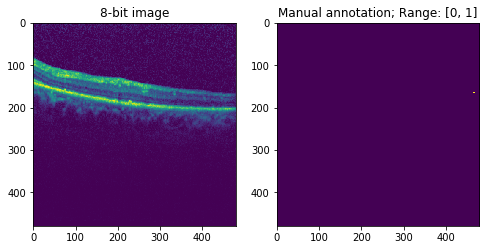

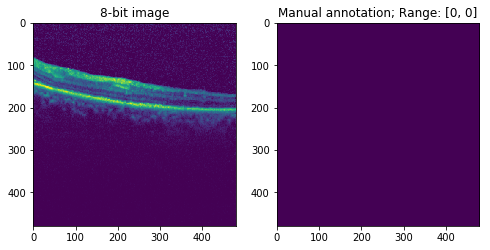

...

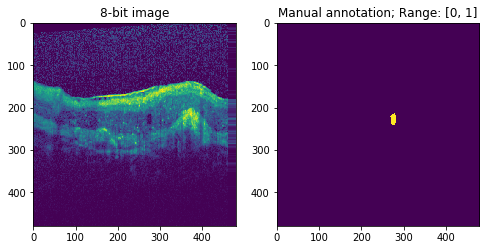

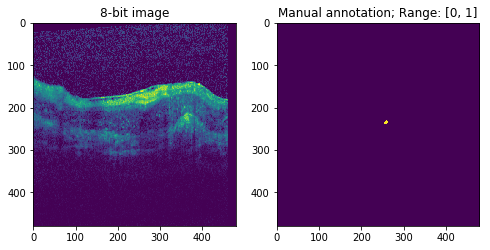

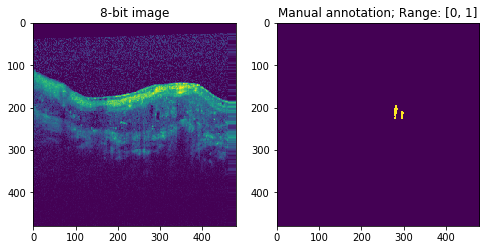

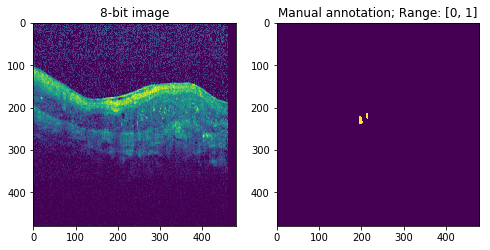

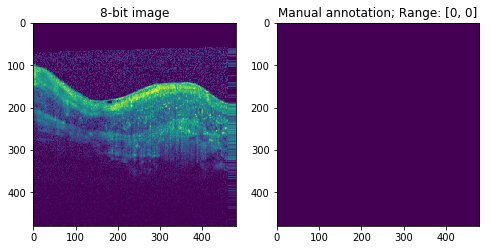

In [46]:
# training set
for i in range(n_tra_imgs):
    training_data.show_image(i)

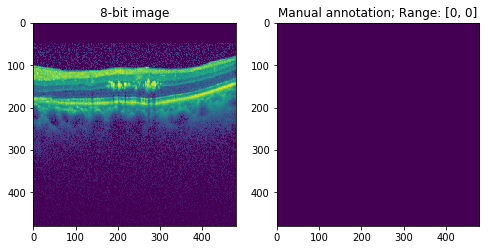

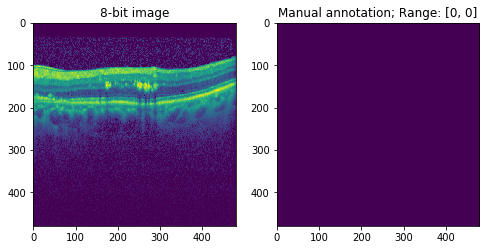

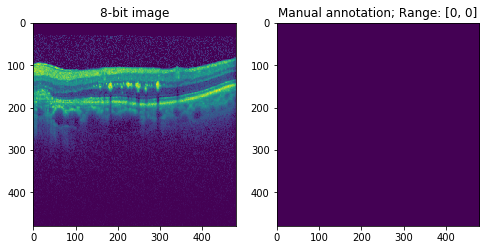

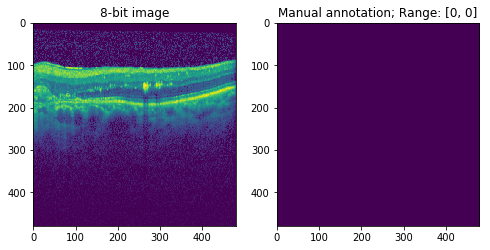

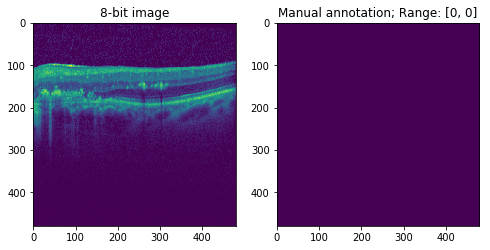

...

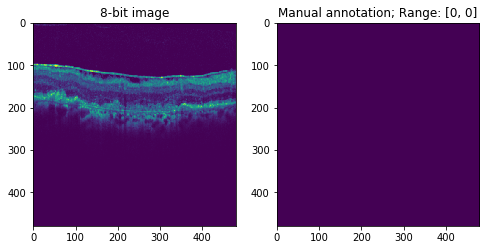

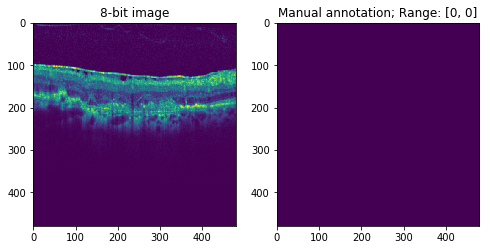

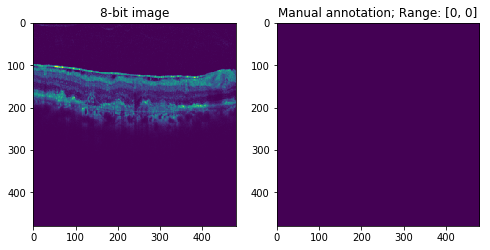

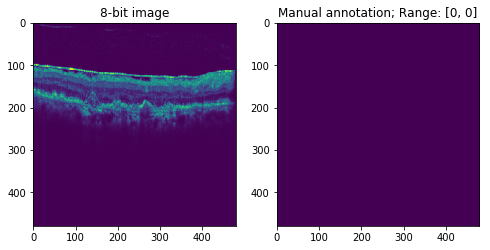

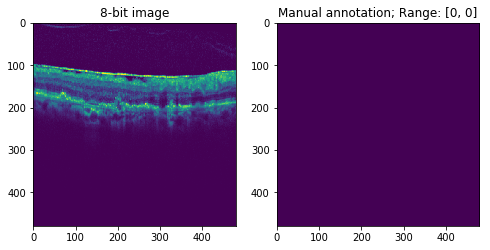

In [47]:
# validation set
for i in range(n_val_imgs):
    validation_data.show_image(i)

Note that manual annotations loaded from disk are already in the range [0, 1], while the X images were stored as grayscale images, where white has an intensity of 255. For training purposes, we need to have labels in the range [0, 1]. Therefore, we do not need to apply the function ``binarize_dataset`` that we have defined before.

### Test batch generator
Before we delve into training U-Net, it is good to test whether the patch generator and the batch generator are working as expected (for example, check if the one-hot encoding is working as expected). Let's test them now.

(16, 480, 480, 1)
(16, 480, 480, 2)


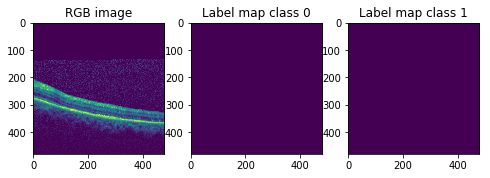

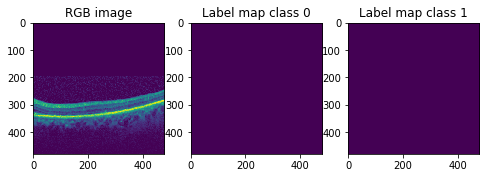

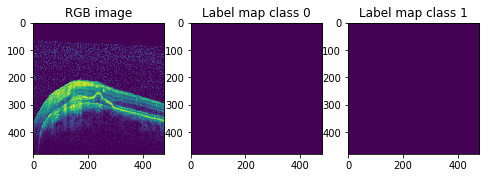

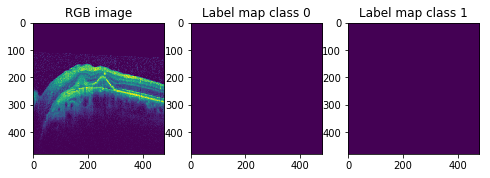

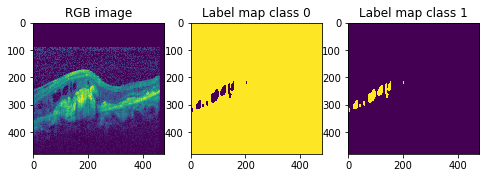

...

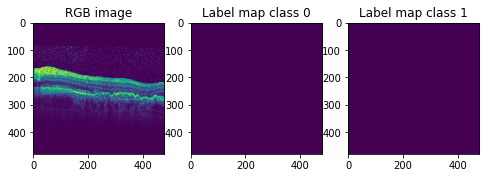

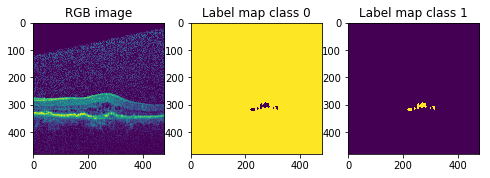

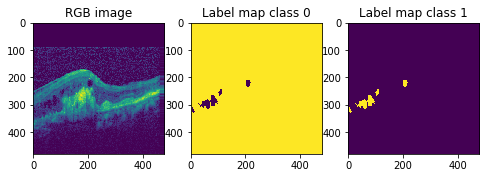

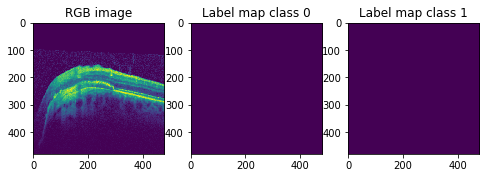

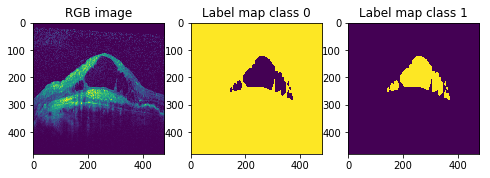

In [48]:
# define parameters batch creator
target_size = (480, 480) # output size, might be the same as input size, but might be smaller, if valid convolutions are used
batch_size = 16 # number of patches in a mini-batch

# intialize batch creator
batch_generator = BatchCreator(training_data, target_size=target_size)

# get one minibatch
x_data, y_data = batch_generator.create_image_batch(batch_size)

print(x_data.shape)
print(y_data.shape)

for i in range(batch_size):
    plt.subplot(1, 3, 1)
    plt.imshow(x_data[i].reshape(480,480)); plt.title('RGB image')
    plt.subplot(1, 3, 2)
    plt.imshow(pad_prediction(y_data[i, :, :, 0].squeeze(), (480,480))); plt.title('Label map class 0')
    plt.subplot(1, 3, 3)
    plt.imshow(pad_prediction(y_data[i, :, :, 1].squeeze(), (480,480))); plt.title('Label map class 1')
    plt.show()
    

Now we have all we need to start building our prediction model with training data.

# Questions:
1. Why do we see the annotated images with color instead of just black and white?

# Train a baseline U-Net model (U-Net 1)
Here we explicitly define a baseline U-Net model. It has a depth of 4 (3 pooling layers), it uses 'same' convolutions, it has 16 filters in the first layer, it accepts inputs of 256x256 RGB images, so it is a very simplified version of the original U-Net. For convenience, we call it ``unet_1``, to differentiat it from other U-Net models that will be built in the rest of the assignment.

In [0]:
def build_unet_1(printmodel=False):
    
    inputs = Input(shape=(480, 480, 1))

    # First conv pool                                             #252
    c1 = Conv2D(16, 3, activation='relu', padding='same')(inputs) #250
    c1 = Conv2D(16, 3, activation='relu', padding='same')(c1)     #248
    p1 = MaxPooling2D()(c1)                                       #124

    # Second conv pool
    c2 = Conv2D(32, 3, activation='relu', padding='same')(p1)     #122
    c2 = Conv2D(32, 3, activation='relu', padding='same')(c2)     #120
    p2 = MaxPooling2D()(c2)                                       #60

    # Third conv pool
    c3 = Conv2D(64, 3, activation='relu', padding='same')(p2)     #58
    c3 = Conv2D(64, 3, activation='relu', padding='same')(c3)     #56
    p3 = MaxPooling2D()(c3)                                       #28

    # Fourth conv pool
    c4 = Conv2D(128, 3, activation='relu', padding='same')(p3)    #26
    c4 = Conv2D(128, 3, activation='relu', padding='same')(c4)    #24
    # missing pool?                                               #24    12
    
    # First up-conv
    u2 = UpSampling2D()(c4)                                       #48    24
    m2 = concatenate([c3, u2])                                    #
    cm2 = Conv2D(64, 3, activation='relu', padding='same')(m2)
    cm2 = Conv2D(64, 3, activation='relu', padding='same')(cm2)

    # Second up-conv
    u3 = UpSampling2D()(cm2)
    m3 = concatenate([c2, u3])
    cm3 = Conv2D(32, 3, activation='relu', padding='same')(m3)
    cm3 = Conv2D(32, 3, activation='relu', padding='same')(cm3)

    # Third up-conv
    u4 = UpSampling2D()(cm3)
    m4 = concatenate([c1, u4])
    cm4 = Conv2D(16, 3, activation='relu', padding='same')(m4)
    cm4 = Conv2D(16, 3, activation='relu', padding='same')(cm4)

    # Output
    predictions = Conv2D(2, 1, activation='softmax')(cm4)

    model = Model(inputs, predictions)
    
    if printmodel:
        print(model.summary())
    
    return model

Make an instance of the ``unet_1`` model.

In [50]:
unet_1 = build_unet_1()

Instructions for updating:
Colocations handled automatically by placer.


In [0]:
def apply_model(model, dataset, experiment_name='basic_unet', make_submission_file=False):
    """Apply a given model to the test set, optionally makes a submission file in ZIP format."""
    
    output_dir = os.path.join('.', experiment_name)
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
        
    #imgs = [image.img for image in dataset]

    for i in range(len(dataset.imgs)):
        fig = plt.figure(figsize=(10,20))
        input_img = np.expand_dims(dataset.imgs[i], axis=0)/255.
        output = model.predict(input_img, batch_size=1)[0, :, :]
        plt.subplot(1, 2, 1); plt.imshow(dataset.imgs[i].reshape(480,480))
        plt.subplot(1, 2, 2); plt.imshow(np.argmax(output, axis=2))
        if make_submission_file:
            prediction = Image.fromarray(np.argmax(output, axis=2).astype(np.uint8))
            prediction.save(os.path.join(output_dir, '{}.png'.format(i)))
        plt.show()
        
    if make_submission_file:
        shutil.make_archive('results', 'zip', output_dir)

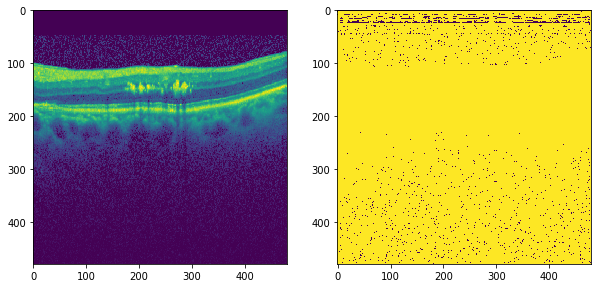

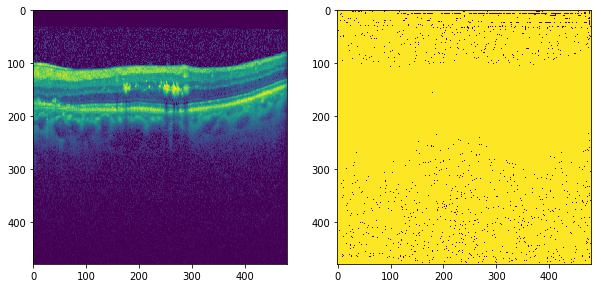

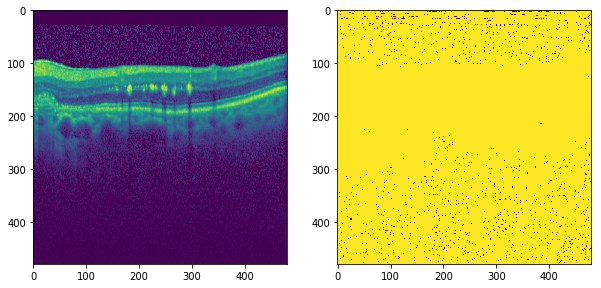

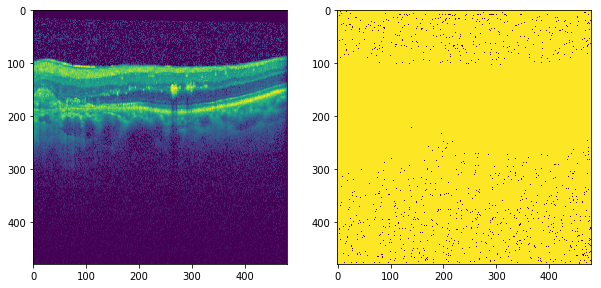

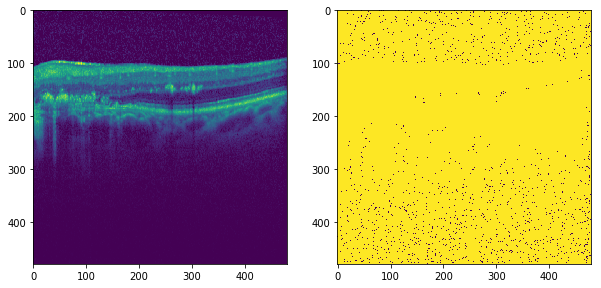

...

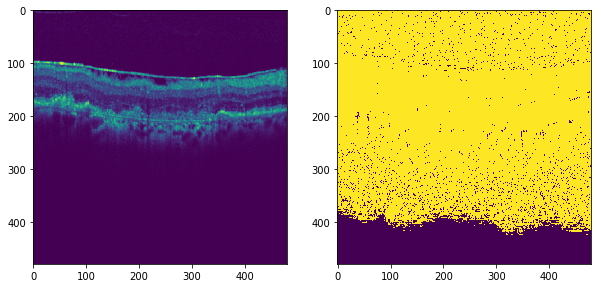

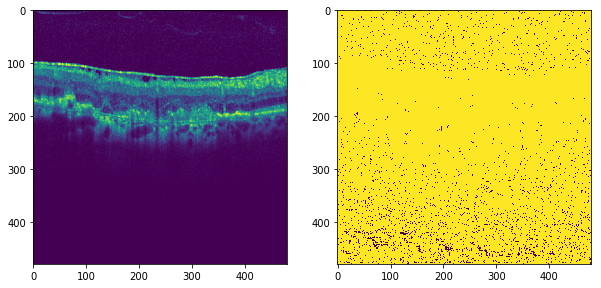

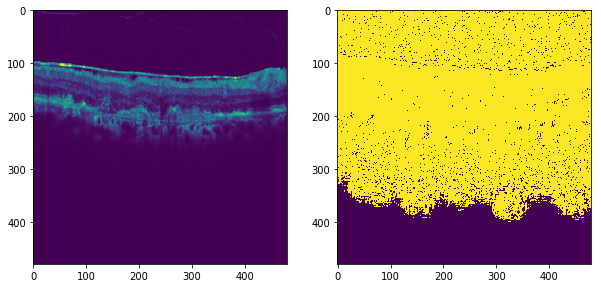

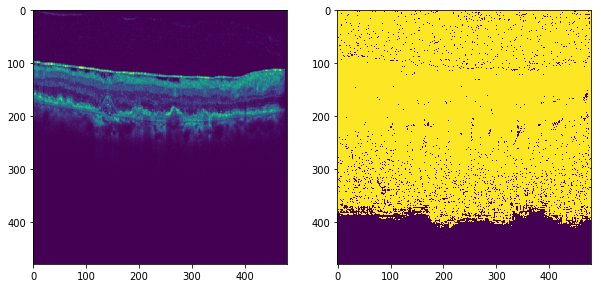

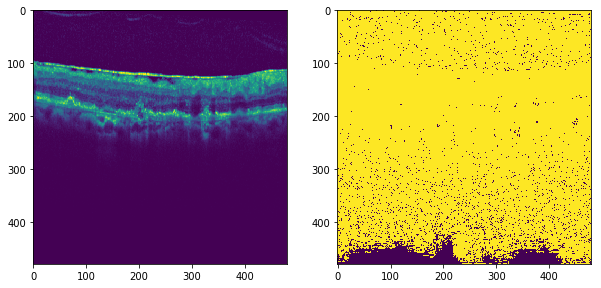

In [0]:
# apply the model to the validation set
apply_model(unet_1, validation_data)

As you can see, the output of randomly initialized parameters is of course very bad.
In the next cell, we initialize all training parameters, define an image generator that will be able to return mini-batches during the training procedure, define a loss function, the mini-batch size, and other parameters needed to train U-Net. Then, we train the model using the ``train_model`` function defined above.

Instructions for updating:
Use tf.cast instead.
Instructions for updating:
Deprecated in favor of operator or tf.math.divide.
Epoch 1/4
5/5 [==============================] - 14s 3s/step - loss: 1.2428 - acc: 0.6220
best model saved as ./unet_1.h5


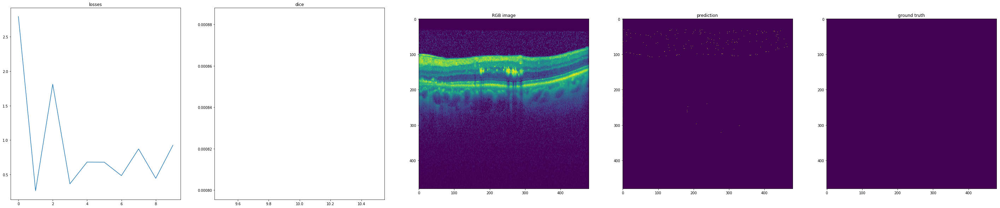

Epoch 2/4
5/5 [==============================] - 5s 1s/step - loss: 0.3903 - acc: 0.9620


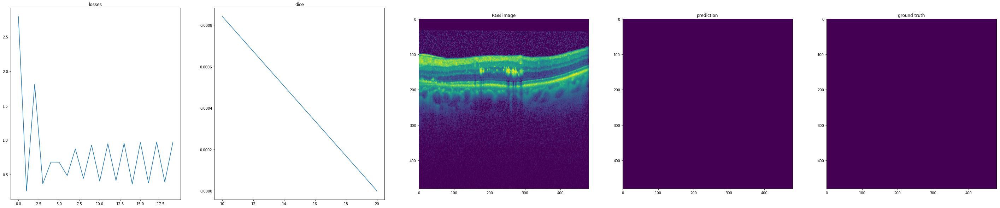

Epoch 3/4
5/5 [==============================] - 5s 1s/step - loss: 0.3547 - acc: 0.9812


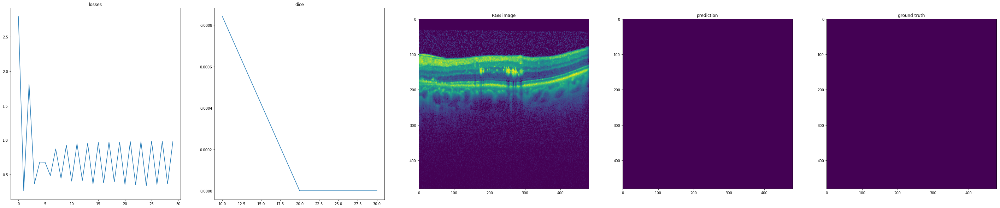

Epoch 4/4
5/5 [==============================] - 5s 1s/step - loss: 0.3379 - acc: 0.9852


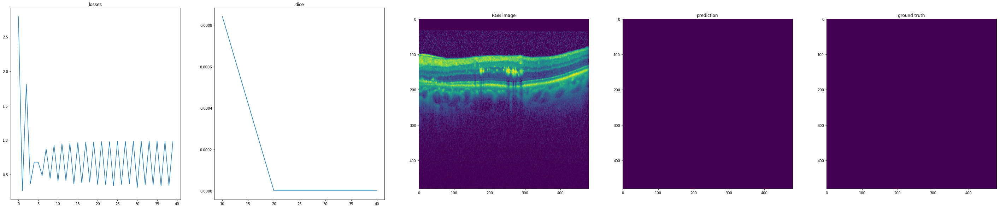

In [52]:
# training parameters

model_name = 'unet_1'

training_params = {}
training_params['learning_rate'] = 0.0001
training_params['patch_size'] = (480, 480) # input size
training_params['target_size'] = (480, 480) # output size, might be the same as input size, but might be smaller, if valid convolutions are used
training_params['batch_size'] = 16 # number of patches in a mini-batch
training_params['steps_per_epoch'] = 5 # number of iterations per epoch
training_params['epochs'] = 4 # number of epochs

training_params['optimizer'] = SGD(lr=training_params['learning_rate'], momentum=0.9, nesterov=True)

training_params['loss'] = ['categorical_crossentropy']
training_params['metrics'] = ['accuracy']
training_params['training_dataset'] = training_dataset
training_params['validation_dataset'] = validation_dataset

# initialize a logger, to keep track of information during training
lost_border = ((training_params['patch_size'][0]-training_params['target_size'][0])//2, (training_params['patch_size'][1]-training_params['target_size'][1])//2)
training_params['logger'] = Logger(validation_data, lost_border, data_dir, model_name)

# train model
train_model(unet_1, training_params)

## Dealing with Unbalanced Classes in Machine Learning - deep ideas

In [0]:
from sklearn.utils import class_weight
class_weights = class_weight.compute_class_weight('balanced',
                                                 np.unique(training_data.lbls),
                                                 training_data.lbls)

TypeError: unhashable type: 'numpy.ndarray'

After training, we can load the best saved model and apply it to the validation set and check the performance:

In [0]:
# load the best model (which gave best Dice score on validation set during training)
unet_1 = load_model(os.path.join(data_dir, model_name + '.h5'))

In [0]:
# apply best model to the validation set first
apply_model(unet_1, validation_dataset)

(18, 496, 508)

Now we can use the function ``apply_model()`` also to process the test set and (optionally) make a submission file.

In [0]:
# apply best model to test set and make a submission file
apply_model(unet_1, test_dataset, 'unet_1', True)

122

You can now download this zipfile with this link: [results.zip](results.zip).  
Next, upload your result to the challenge website (https://ismi-glas.grand-challenge.org/evaluation/results/).

You have realized that this baseline model does not perform well at all!
You can of course play around with ome hyperparameters (learning rate, mini-batch size, etc.) and try to improve performance. We tried a bit and with this architecture we could not get very good performance. The good news is that now you have an example and a full pipeline that you can use to build your own U-Net model and improve the performance! In the next cells, we will provide some guidance how to make U-Net work better, starting with adding batch normalization.